In [21]:
import itertools
import random

import torch
from torch.nn import Linear
from torch.nn import functional as F
from torch.optim import Adam
from torch_geometric import utils
from torch_geometric.data import Data
from torch_geometric.datasets import TUDataset
from torch_geometric.nn import BatchNorm, MessagePassing, TopKPooling, dense_mincut_pool
from torch_geometric.transforms import NormalizeFeatures
from torch_scatter import scatter_mean

from custom.utils import *

In [22]:
class GraphMatchingConvolution(MessagePassing):
    def __init__(self, in_channels, out_channels, args, aggr="add"):
        super(GraphMatchingConvolution, self).__init__(aggr=aggr)
        self.args = args
        self.lin_node = torch.nn.Linear(in_channels, out_channels)
        self.lin_message = torch.nn.Linear(out_channels * 2, out_channels)
        self.lin_passing = torch.nn.Linear(out_channels + in_channels, out_channels)
        self.batch_norm = BatchNorm(out_channels)

    def forward(self, x, edge_index, batch):
        x_transformed = self.lin_node(x)
        return self.propagate(edge_index, x=x_transformed, original_x=x, batch=batch)

    def message(self, edge_index_i, x_i, x_j):
        x = torch.cat([x_i, x_j], dim=1)
        m = self.lin_message(x)
        return m

    def update(self, aggr_out, edge_index, x, original_x, batch):
        n_graphs = torch.unique(batch).shape[0]
        cross_graph_attention, a_x, a_y = batch_block_pair_attention(
            original_x, batch, n_graphs
        )
        attention_input = original_x - cross_graph_attention
        aggr_out = self.lin_passing(torch.cat([aggr_out, attention_input], dim=1))
        aggr_out = self.batch_norm(aggr_out)
        return (
            aggr_out,
            edge_index,
            batch,
            (attention_input, cross_graph_attention, a_x, a_y),
        )


class GraphAggregator(torch.nn.Module):
    def __init__(self, in_channels, out_channels, args):
        super(GraphAggregator, self).__init__()
        self.lin = torch.nn.Linear(in_channels, out_channels)
        self.lin_gate = torch.nn.Linear(in_channels, out_channels)
        self.lin_final = torch.nn.Linear(out_channels, out_channels)
        self.args = args

    def forward(self, x, edge_index, batch):
        x_states = self.lin(x)
        x_gates = torch.nn.functional.softmax(self.lin_gate(x), dim=1)
        x_states = x_states * x_gates
        x_states = scatter_mean(x_states, batch, dim=0)
        x_states = self.lin_final(x_states)
        return x_states

In [23]:
class GraphMatchingNetwork(torch.nn.Module):
    def __init__(self, args):
        super(GraphMatchingNetwork, self).__init__()
        self.args = args
        self.margin = self.args.margin
        if args.n_classes > 2:
            self.f1_average = "micro"
        else:
            self.f1_average = "binary"
        self.layers = torch.nn.ModuleList()
        self.layers.append(
            GraphMatchingConvolution(self.args.feat_dim, self.args.dim, args)
        )
        for _ in range(self.args.num_layers - 1):
            self.layers.append(
                GraphMatchingConvolution(self.args.dim, self.args.dim, args)
            )
        self.aggregator = GraphAggregator(self.args.dim, self.args.dim, self.args)
        self.layer_outputs = []
        self.layer_cross_attentions = []
        self.pool = []
        self.args.n_clusters = args.n_clusters
        self.topk_pooling = TopKPooling(self.args.dim, ratio=self.args.n_clusters)
        self.topk_outputs = []
        self.mlp = torch.nn.Sequential()
        self.mlp.append(Linear(self.args.dim, self.args.n_clusters))

    def compute_emb(
        self,
        feats,
        edge_index,
        batch,
        sizes_1,
        sizes_2,
        edge_index_1,
        edge_index_2,
        k=None,
    ):
        topk_pooling = TopKPooling(
            self.args.dim, ratio=k if k else self.args.n_clusters
        )
        for i in range(self.args.num_layers):
            (
                feats,
                edge_index,
                batch,
                (attention_input, cross_graph_attention, a_x, a_y),
            ) = self.layers[i](feats, edge_index, batch)
            x_1 = feats[: sizes_1.item(), :]
            x_2 = feats[sizes_1.item() : sizes_1.item() + sizes_2.item(), :]
            x_pooled_1, edge_index_pooled_1, _, _, perm1, _ = topk_pooling(
                x_1,
                edge_index_1,
            )
            x_pooled_2, edge_index_pooled_2, _, _, perm2, _ = topk_pooling(
                x_2,
                edge_index_2,
            )
            self.topk_outputs.append(
                (
                    (x_pooled_1, edge_index_pooled_1, perm1),
                    (x_pooled_2, edge_index_pooled_2, perm2),
                )
            )

            s_1 = self.mlp(x_1)
            adj_1 = utils.to_dense_adj(edge_index_1).float()
            x_pooled_1, adj_pooled_1, mc_loss_1, o_loss_1 = dense_mincut_pool(
                x_1, adj_1, s_1
            )
            s_2 = self.mlp(x_2)
            adj_2 = utils.to_dense_adj(edge_index_2).float()
            x_pooled_2, adj_pooled_2, mc_loss_2, o_loss_2 = dense_mincut_pool(
                x_2, adj_2, s_2
            )
            edge_index_pool_1 = utils.dense_to_sparse(adj_pooled_1)[0]
            edge_index_pool_2 = utils.dense_to_sparse(adj_pooled_2)[0]
            clustered_graph_1 = Data(x=x_pooled_1[0], edge_index=edge_index_pool_1)
            clustered_graph_2 = Data(x=x_pooled_2[0], edge_index=edge_index_pool_2)
            self.pool.append(
                (
                    (clustered_graph_1, mc_loss_1, o_loss_1),
                    (clustered_graph_2, mc_loss_2, o_loss_2),
                )
            )
            self.layer_cross_attentions.append((cross_graph_attention, a_x, a_y))
            self.layer_outputs.append((x_1, x_2))

        feats = self.aggregator(feats, edge_index, batch)
        return feats, edge_index, batch

    def combine_pair_embedding(
        self, feats_1, edge_index_1, feats_2, edge_index_2, sizes_1, sizes_2
    ):
        feats = torch.cat([feats_1, feats_2], dim=0)
        max_node_idx_1 = sizes_1.sum()
        edge_index_2_offset = edge_index_2 + max_node_idx_1
        edge_index = torch.cat([edge_index_1, edge_index_2_offset], dim=1)
        batch = create_batch(torch.cat([sizes_1, sizes_2], dim=0))
        feats, edge_index, batch = (
            feats.to(self.args.device),
            edge_index.to(self.args.device),
            batch.to(self.args.device),
        )
        return feats, edge_index, batch

    def forward(
        self, feats_1, edge_index_1, feats_2, edge_index_2, sizes_1, sizes_2, k=None
    ):
        self.layer_outputs = []
        self.layer_cross_attentions = []
        self.topk_outputs = []
        self.pool = []
        feats, edge_index, batch = self.combine_pair_embedding(
            feats_1, edge_index_1, feats_2, edge_index_2, sizes_1, sizes_2
        )
        emb, _, _ = self.compute_emb(
            feats, edge_index, batch, sizes_1, sizes_2, edge_index_1, edge_index_2, k
        )
        emb_1 = emb[: emb.shape[0] // 2, :]
        emb_2 = emb[emb.shape[0] // 2 :, :]

        best_acc1, best_acc2 = 0.0, 0.0
        cluster1, cluster2 = None, None
        for i in range(len(self.topk_outputs)):
            (
                (x_pooled_1, edge_index_pooled_1, perm1),
                (x_pooled_2, edge_index_pooled_2, perm2),
            ) = self.topk_outputs[i]
            acc1 = len(set(range(8)) & set(perm1.tolist()))
            acc2 = len(set(range(8)) & set(perm2.tolist()))
            if acc1 > best_acc1:
                cluster1 = Data(x=x_pooled_1, edge_index=edge_index_pooled_1)
                best_acc1 = acc1
            if acc2 > best_acc2:
                cluster2 = Data(x=x_pooled_2, edge_index=edge_index_pooled_2)
                best_acc2 = acc2

        return emb_1, emb_2, cluster1, cluster2

    def compute_metrics(self, emb_1, emb_2, labels):
        distances = torch.norm(emb_1 - emb_2, p=2, dim=1)
        loss = F.relu(self.margin - labels * (1 - distances)).mean()
        predicted_similar = torch.where(
            distances < self.args.margin,
            torch.ones_like(labels),
            -torch.ones_like(labels),
        )
        acc = (predicted_similar == labels).float().mean()
        metrics = {"loss": loss, "acc": acc}
        return metrics

    def init_metric_dict(self):
        return {"acc": -1, "f1": -1}

    def has_improved(self, m1, m2):
        return m1["acc"] < m2["acc"]

MUTAG one-hot: (0=C, 1=N, 2=O, 3=F, 4=I, 5=Cl, 6=Br)

Total number of graphs: 600
Number of classes: 6
Number of node features: 21
Average number of nodes per graph: 32
Max number of nodes in a graph: 126
Min number of nodes in a graph: 2
Class distribution:
 - Class 5: 100 graphs (16.67%)
 - Class 4: 100 graphs (16.67%)
 - Class 0: 100 graphs (16.67%)
 - Class 1: 100 graphs (16.67%)
 - Class 2: 100 graphs (16.67%)
 - Class 3: 100 graphs (16.67%)


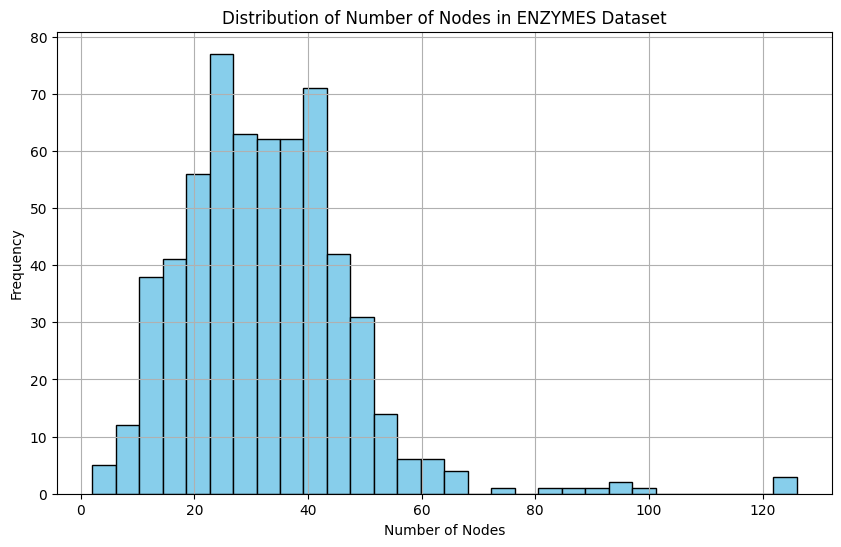

Small graphs: 279
Medium graphs: 305
Large graphs: 16


In [24]:
dataset = TUDataset(
    root="data", name="ENZYMES", use_node_attr=True, transform=NormalizeFeatures()
)

small_graphs, medium_graphs, large_graphs, classes = analyze_dataset(dataset, 10, 20)

In [25]:
data = [graph for graph in dataset if 10 <= graph.num_nodes <= 20]

In [26]:
def train(model, optimizer, pairs, labels, batch_size, title="", a=0.0):
    model.train()
    train_losses = []
    train_accuracies = []
    losses = []
    accs = []

    for i in range(len(pairs)):
        optimizer.zero_grad()

        graph1, graph2 = pairs[i]
        label = labels[i]

        feats_1, edge_index_1 = graph1.x, graph1.edge_index
        feats_2, edge_index_2 = graph2.x, graph2.edge_index
        sizes_1 = torch.tensor([graph1.num_nodes])
        sizes_2 = torch.tensor([graph2.num_nodes])

        emb_1, emb_2, _, _ = model(
            feats_1, edge_index_1, feats_2, edge_index_2, sizes_1, sizes_2
        )

        (
            (_, mc_loss_1, o_loss_1),
            (_, mc_loss_2, o_loss_2),
        ) = model.pool[-1]

        metrics = model.compute_metrics(emb_1, emb_2, torch.tensor([label]))
        loss = metrics["loss"]
        acc = metrics["acc"]

        loss += a * ((mc_loss_1 + o_loss_1 + mc_loss_2 + o_loss_2) / 2)

        losses.append(loss)
        accs.append(acc)

        if i % batch_size == 0 and i > 0:
            batch_loss = torch.mean(torch.stack(losses))
            batch_acc = torch.mean(torch.stack(accs))
            losses = []
            accs = []
            train_losses.append(batch_loss.detach().numpy())
            train_accuracies.append(batch_acc.detach().numpy())
            batch_loss.backward()
            optimizer.step()

    plt.figure(figsize=(12, 5))

    plt.suptitle(title)

    plt.subplot(1, 2, 1)
    plt.plot(train_losses, label="Training Loss")
    plt.title("Loss over Epochs")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(train_accuracies, label="Training Accuracy")
    plt.title("Accuracy over Epochs")
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.legend()

    plt.show()

In [27]:
def test(model, title="", layers=3, num_classes=2, n=0, k=None):
    class_clusters = []
    class_accs = []
    class_circles = []
    for i in range(num_classes):
        c = f"class_{str(i)}"
        idx1 = random.sample(range(len(classes[c])), 1)[0]
        idx2 = random.sample(range(len(classes[c])), 1)[0]
        graph1, graph2 = classes[c][idx1], classes[c][idx2]

        model.eval()

        feats_1, edge_index_1 = graph1.x, graph1.edge_index
        feats_2, edge_index_2 = graph2.x, graph2.edge_index
        sizes_1 = torch.tensor([len(graph1.x)])
        sizes_2 = torch.tensor([len(graph2.x)])
        _, _, cluster1, cluster2 = model(
            feats_1, edge_index_1, feats_2, edge_index_2, sizes_1, sizes_2, k
        )

        clusters = []
        accs = []
        circles = []

        for i in range(len(model.topk_outputs)):
            (
                (x_pooled_1, edge_index_pooled_1, perm1),
                (x_pooled_2, edge_index_pooled_2, perm2),
            ) = model.topk_outputs[i]
            clusters.append(
                (
                    Data(x=x_pooled_1, edge_index=edge_index_pooled_1),
                    Data(x=x_pooled_2, edge_index=edge_index_pooled_2),
                )
            )

            accs.append(
                (
                    len(set(range(8)) & set(perm1.tolist())),
                    len(set(range(8)) & set(perm2.tolist())),
                )
            )
            # circles.append(
            #     (
            #         len(
            #             list(
            #                 nx.simple_cycles(
            #                     to_networkx(
            #                         Data(x=x_pooled_1, edge_index=edge_index_pooled_1),
            #                         to_undirected=True,
            #                     )
            #                 )
            #             )
            #         ),
            #         len(
            #             list(
            #                 nx.simple_cycles(
            #                     to_networkx(
            #                         Data(x=x_pooled_2, edge_index=edge_index_pooled_2),
            #                         to_undirected=True,
            #                     )
            #                 )
            #             )
            #         ),
            #     )
            # )

        acc = list(itertools.chain.from_iterable(zip(*accs)))
        class_accs.extend(acc)

        cs = list(itertools.chain.from_iterable(zip(*clusters)))
        class_clusters.extend(cs)

        (
            (cluster1, _, _),
            (cluster2, _, _),
        ) = model.pool[-1]

        plot_graph_pair(cluster1, cluster2, title="mincut")

        # c = list(itertools.chain.from_iterable(zip(*circles)))
        # class_circles.extend(c)

    # plot_all_classes(class_clusters, class_accs, title, layers, num_classes)

In [28]:
hyperparameters_mutag = [
    (32, 3, 0.2, 0.001, 64, 500),
    (32, 3, 0.4, 0.01, 16, 1000),
    (32, 3, 0.4, 0.01, 32, 1000),
    (32, 3, 0.4, 0.01, 64, 3000),
    (32, 3, 0.5, 0.01, 64, 1000),
    (32, 3, 0.5, 0.01, 128, 3000),
    (32, 3, 0.5, 0.001, 64, 3000),
    (32, 4, 0.1, 0.01, 16, 500),
    (32, 4, 0.1, 0.001, 32, 1000),
    (32, 4, 0.3, 0.0001, 16, 500),
    (32, 4, 0.4, 0.001, 32, 1000),
    (32, 4, 0.5, 0.01, 32, 500),
    (32, 4, 0.5, 0.01, 64, 1000),
    (32, 4, 0.5, 0.01, 128, 2000),
    (32, 4, 0.5, 0.01, 128, 3000),
    (32, 4, 0.5, 0.001, 64, 2000),
    (32, 4, 1, 0.01, 32, 500),
    (32, 4, 1, 0.01, 128, 2000),
    (32, 5, 0.2, 0.0001, 64, 1000),
    (32, 5, 0.1, 0.01, 64, 1000),
    (32, 4, 1, 0.01, 128, 2000),
    (32, 5, 1, 0.001, 64, 2000),
    (32, 6, 0.2, 0.001, 16, 2000),
    (32, 7, 0.2, 0.001, 16, 500),
    (32, 7, 0.4, 0.001, 64, 500),
    (32, 7, 0.4, 0.001, 128, 1000),
    (32, 8, 0.2, 0.001, 64, 2000),
    (32, 8, 0.5, 0.01, 64, 3000),
]

In [29]:
hyperparameters_enzymes = [
    (16, 3, 0.3, 0.01, 128, 10000),
    (16, 3, 0.3, 0.01, 256, 2500),
    (16, 3, 0.5, 0.01, 128, 10000),
    (16, 3, 0.5, 0.01, 256, 10000),
    (16, 4, 0.3, 0.01, 128, 10000),
    (16, 4, 0.3, 0.01, 256, 10000),
    (16, 4, 0.3, 0.001, 256, 10000),
    (16, 4, 0.5, 0.01, 128, 10000),
    (16, 4, 0.5, 0.001, 256, 10000),
    (16, 4, 1, 0.001, 128, 10000),
    (16, 5, 0.3, 0.01, 256, 10000),
    (16, 5, 0.5, 0.01, 256, 10000),
    (16, 6, 0.3, 0.01, 256, 10000),
    (16, 6, 0.3, 0.001, 256, 10000),
    (16, 6, 0.5, 0.01, 256, 10000),
    (16, 7, 0.3, 0.01, 256, 10000),
    (16, 8, 0.3, 0.01, 256, 10000),
    (16, 8, 0.5, 0.01, 256, 10000),
    (32, 4, 0.1, 0.01, 256, 10000),
    (32, 4, 0.3, 0.01, 256, 10000),
    (32, 4, 0.3, 0.001, 256, 10000),
    (32, 4, 0.5, 0.01, 256, 10000),
    (32, 5, 0.1, 0.01, 256, 10000),
    (32, 5, 0.1, 0.001, 256, 10000),
    (32, 6, 0.5, 0.01, 256, 10000),
    (32, 8, 0.3, 0.01, 256, 10000),
]

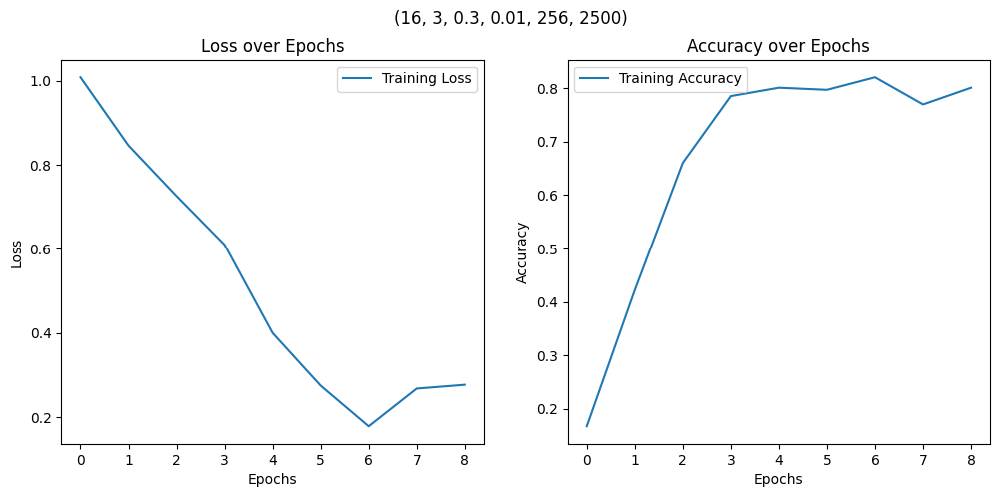

6


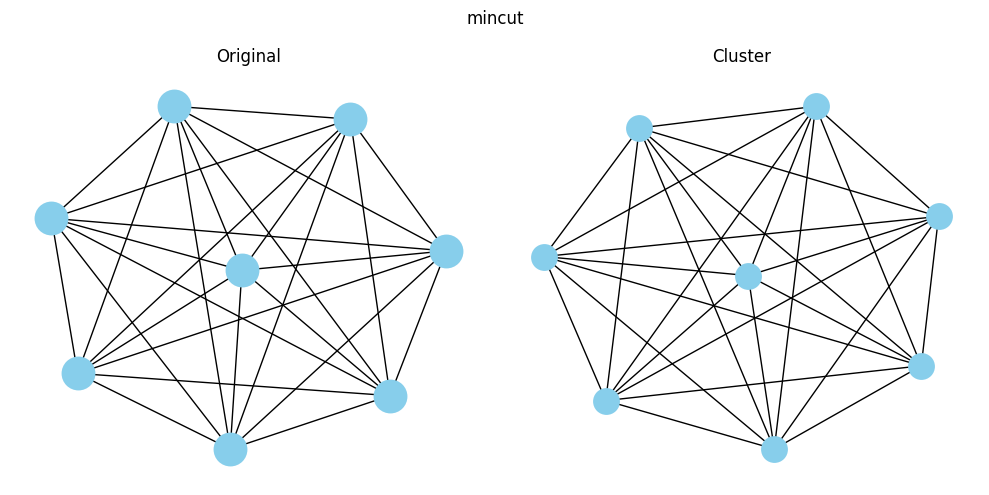

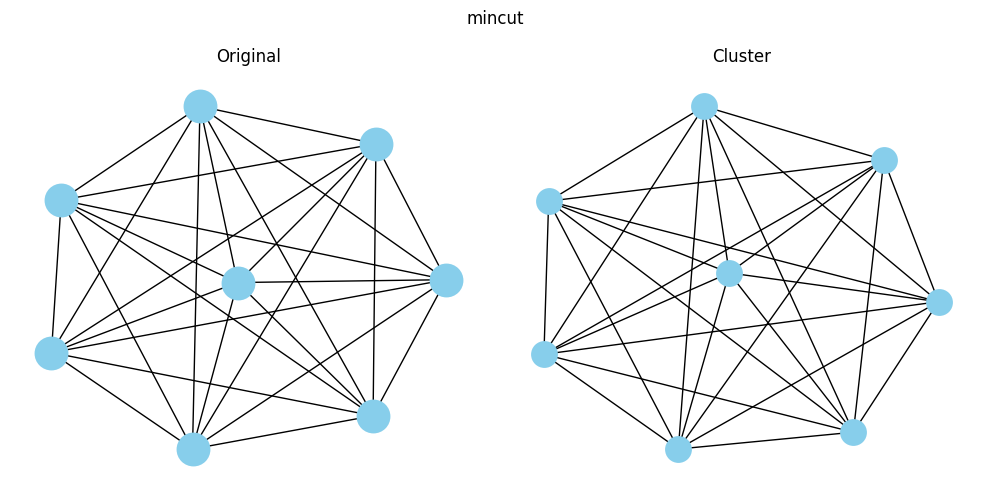

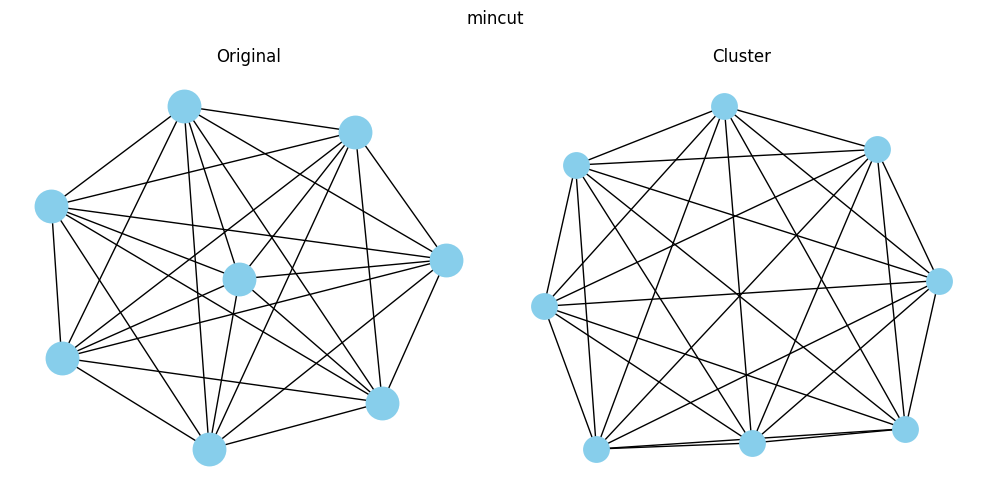

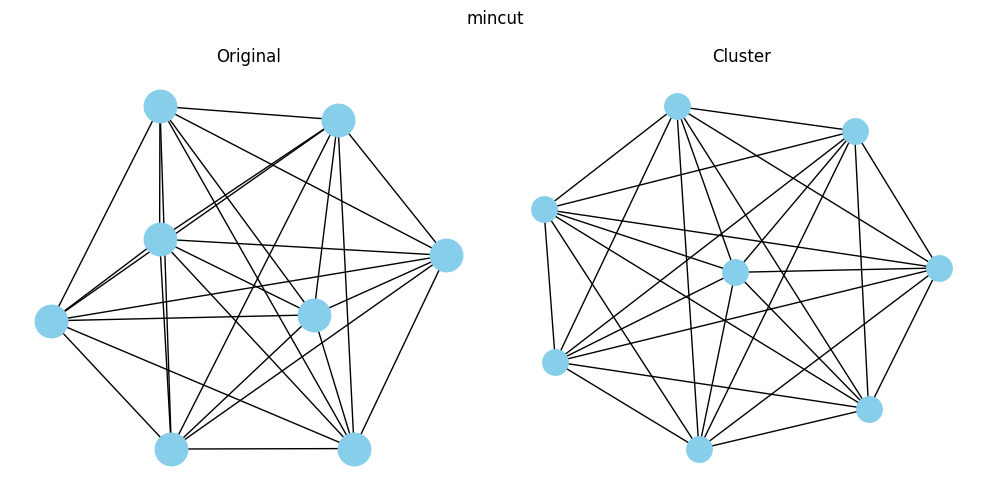

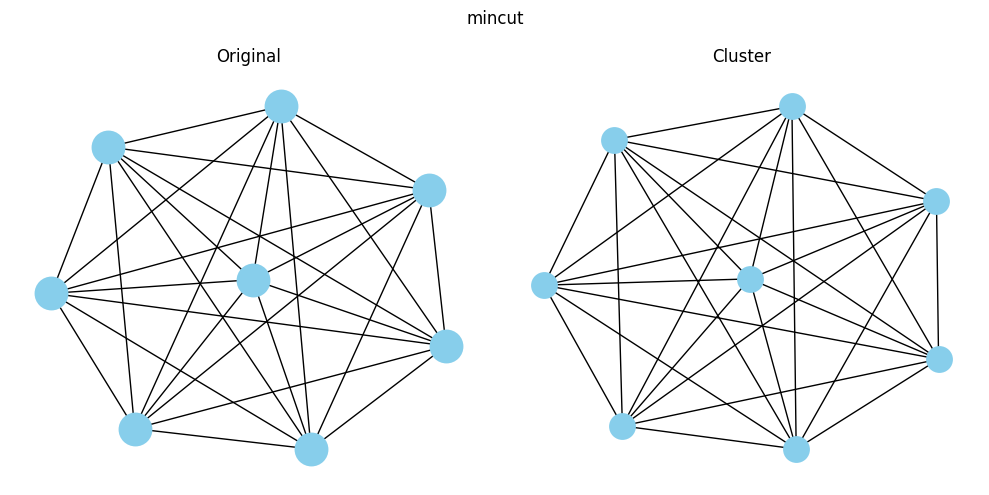

...

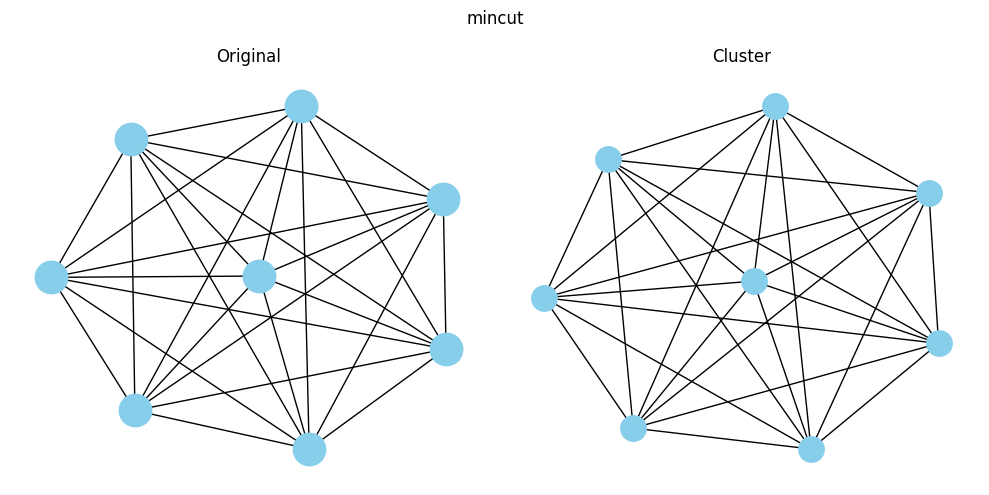

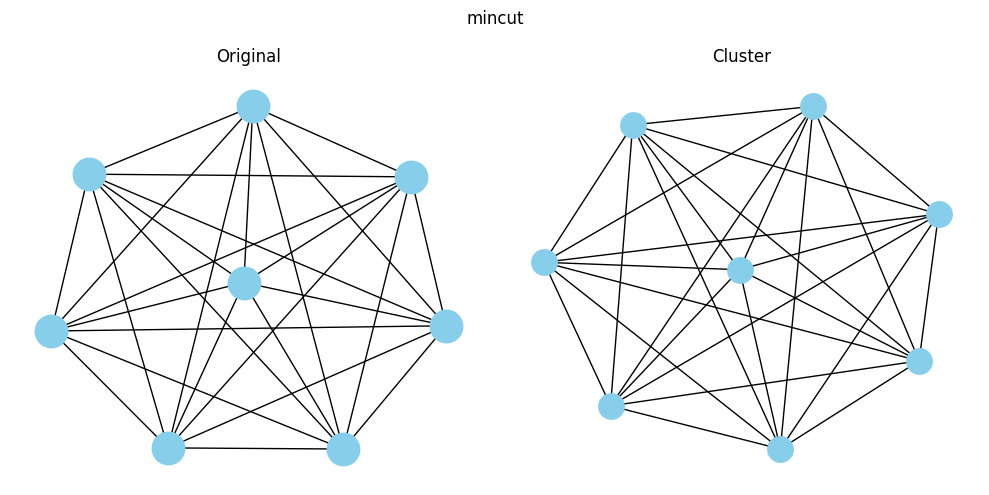

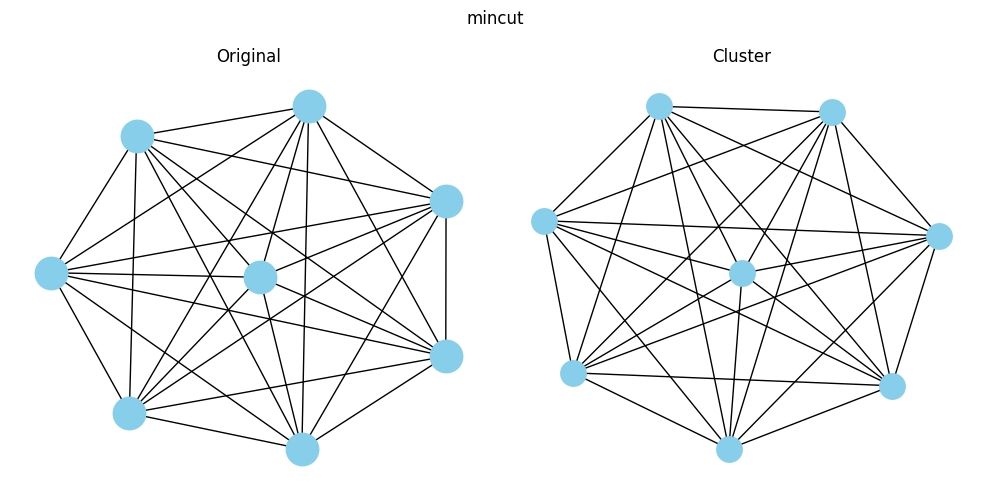

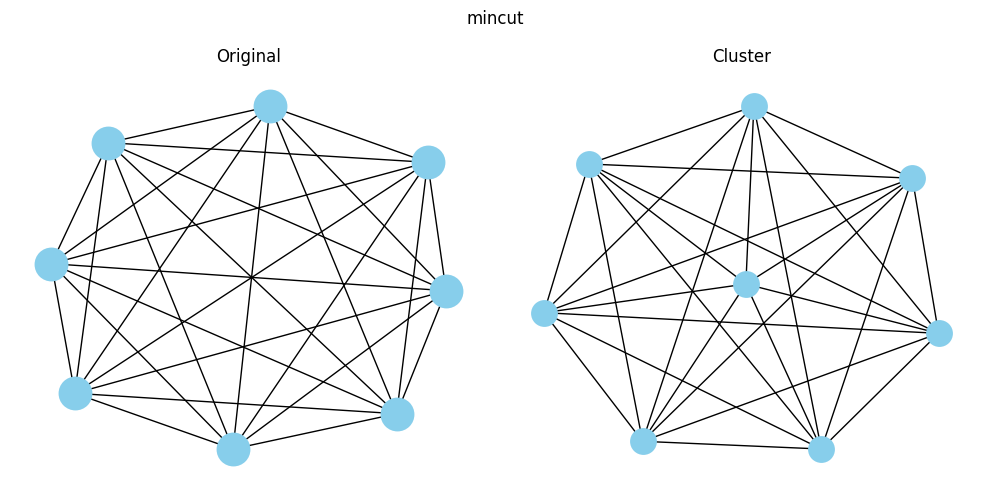

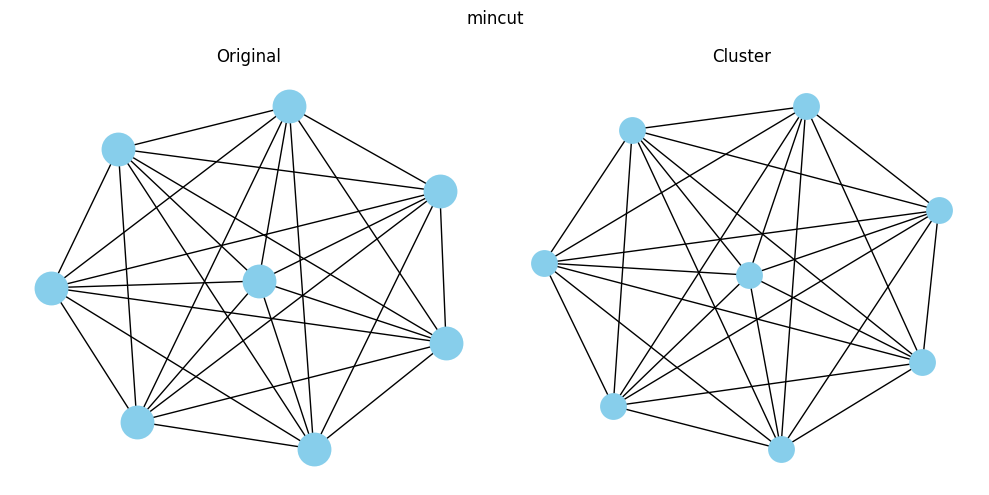

---------------------------------------------------------
7


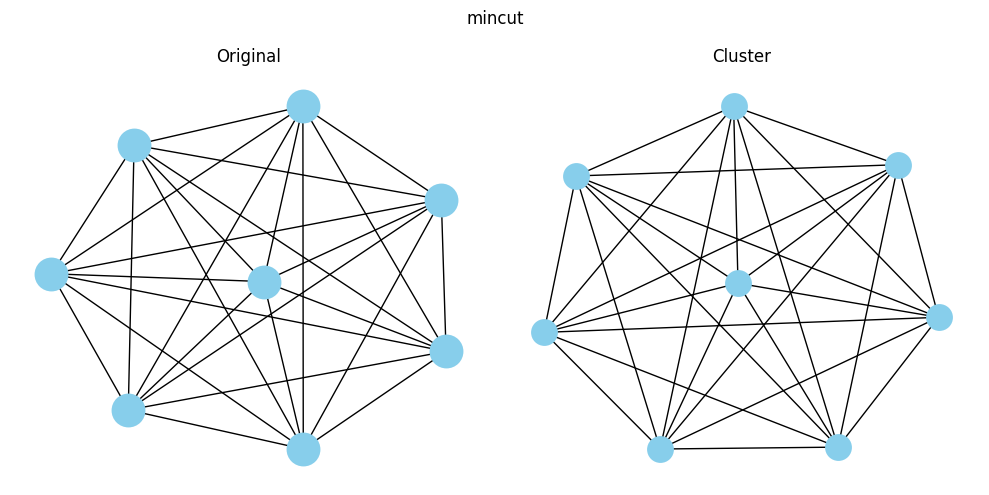

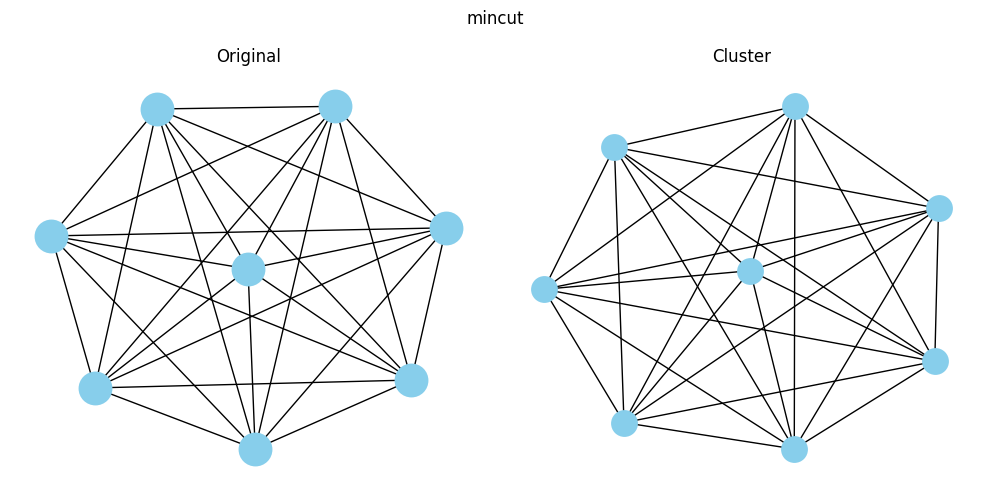

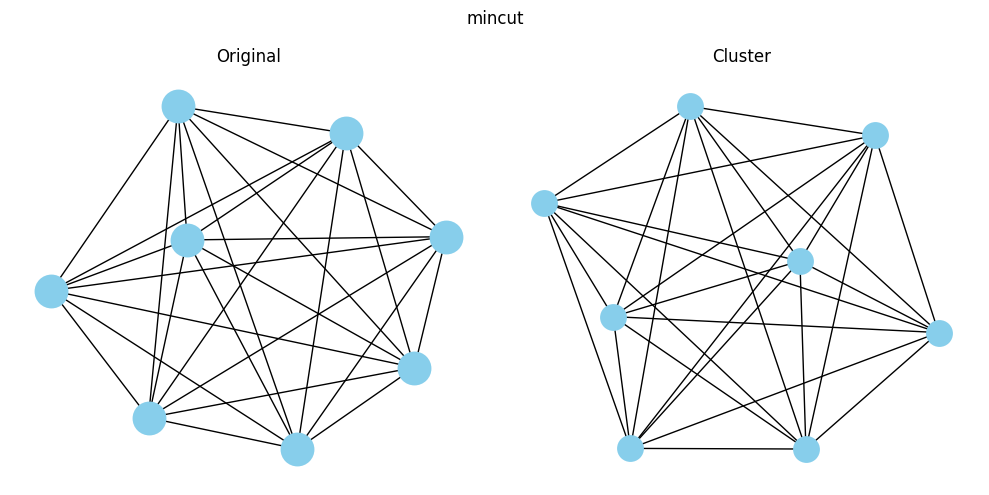

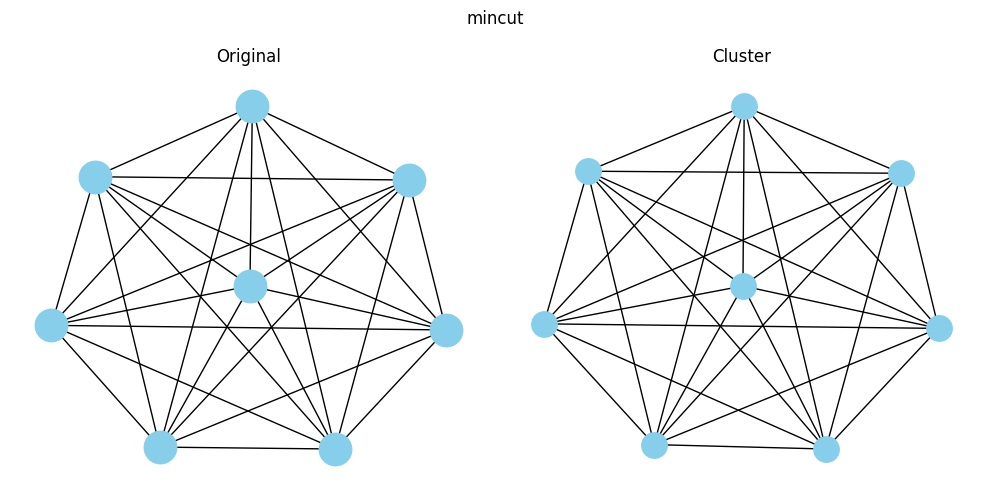

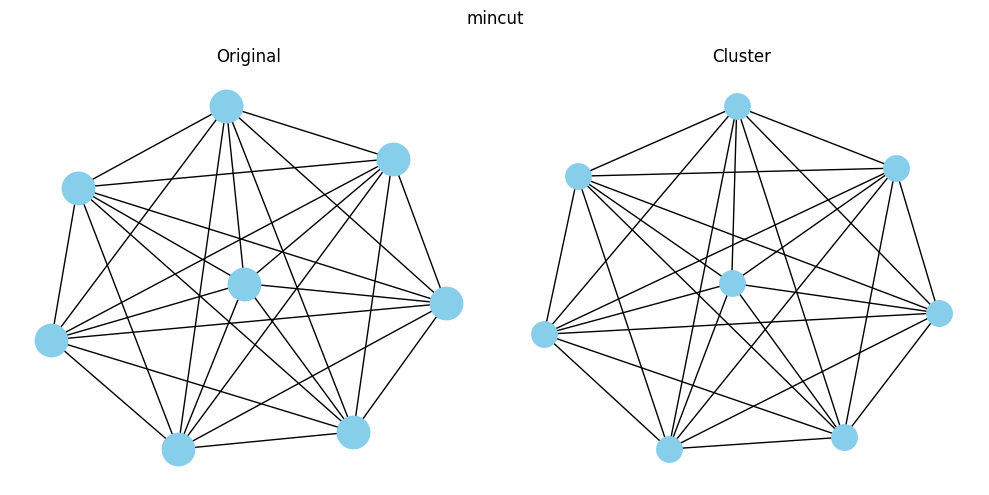

...

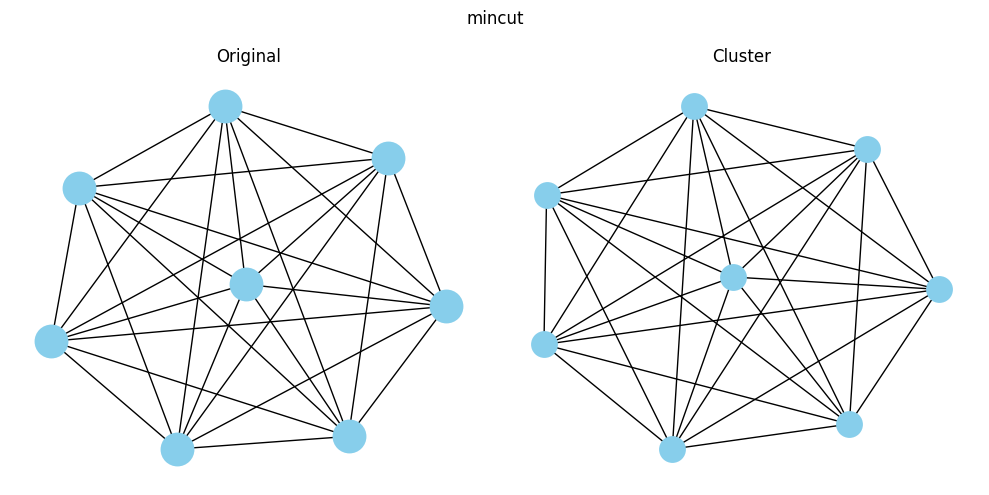

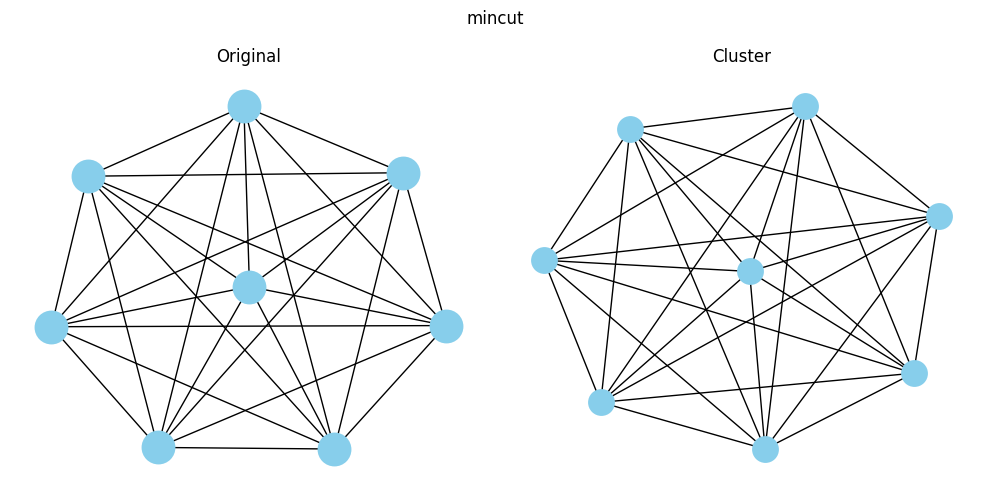

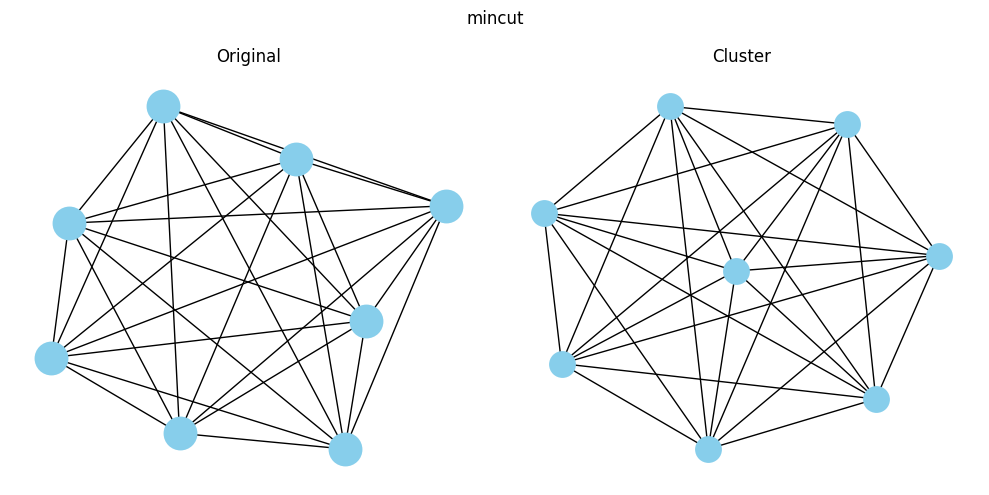

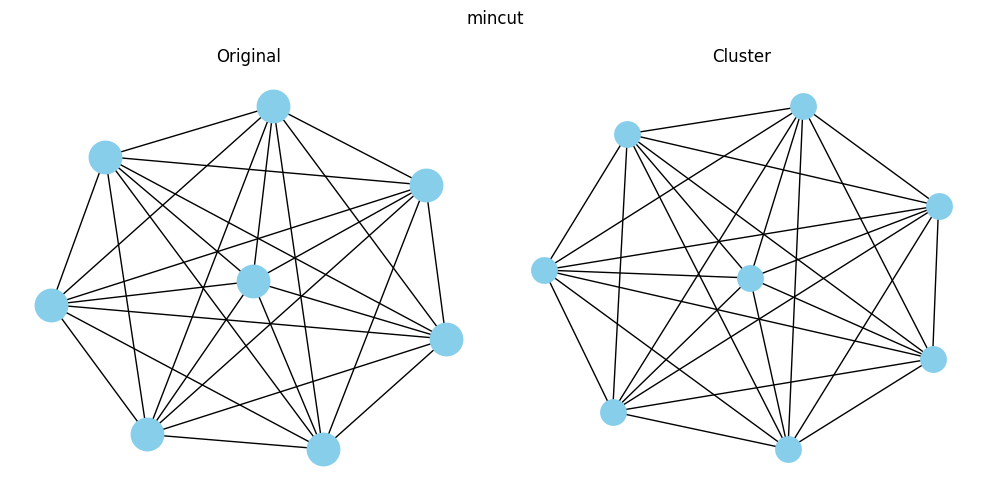

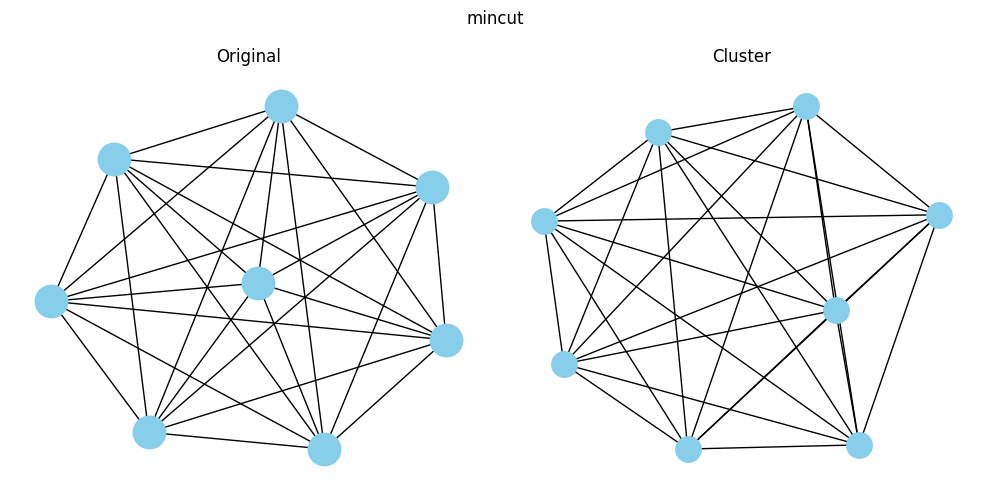

---------------------------------------------------------
8


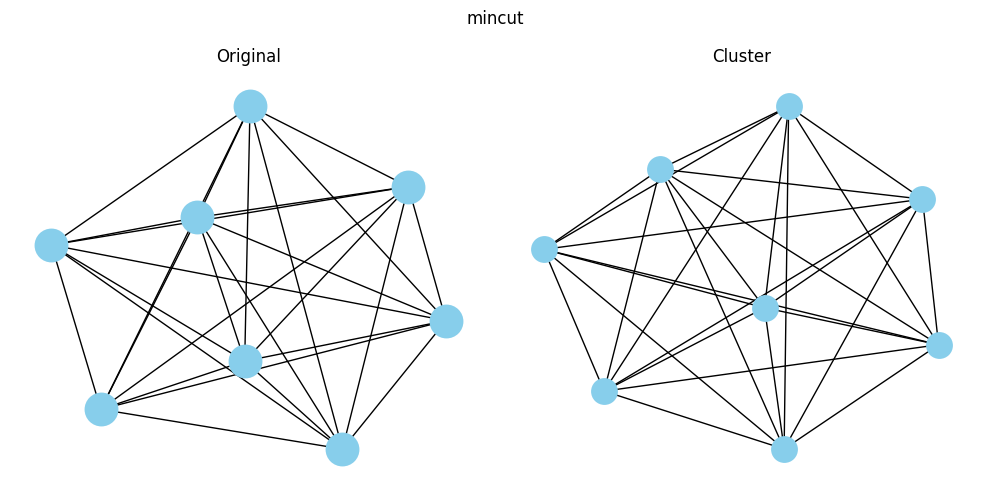

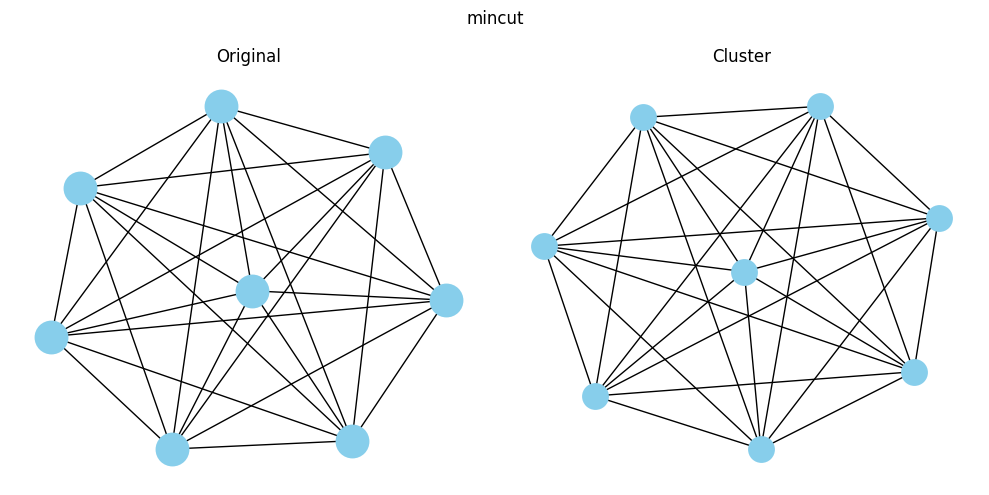

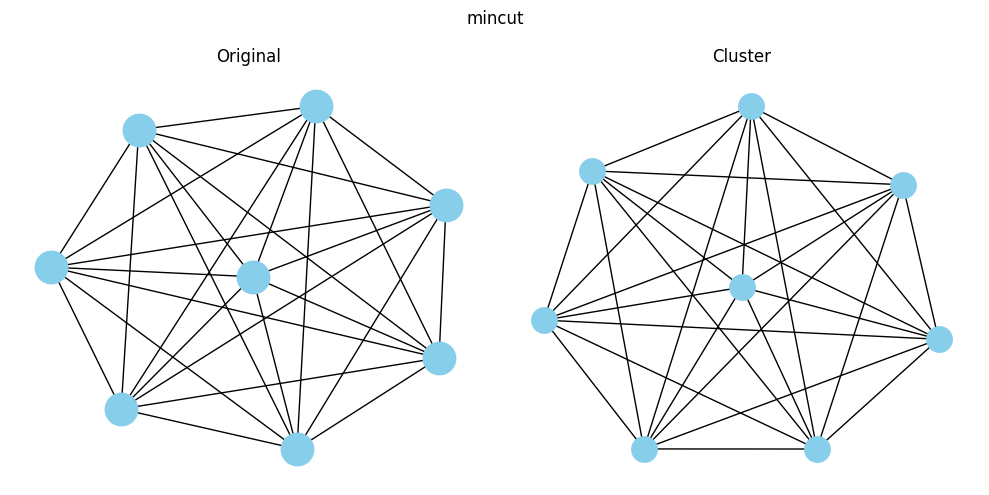

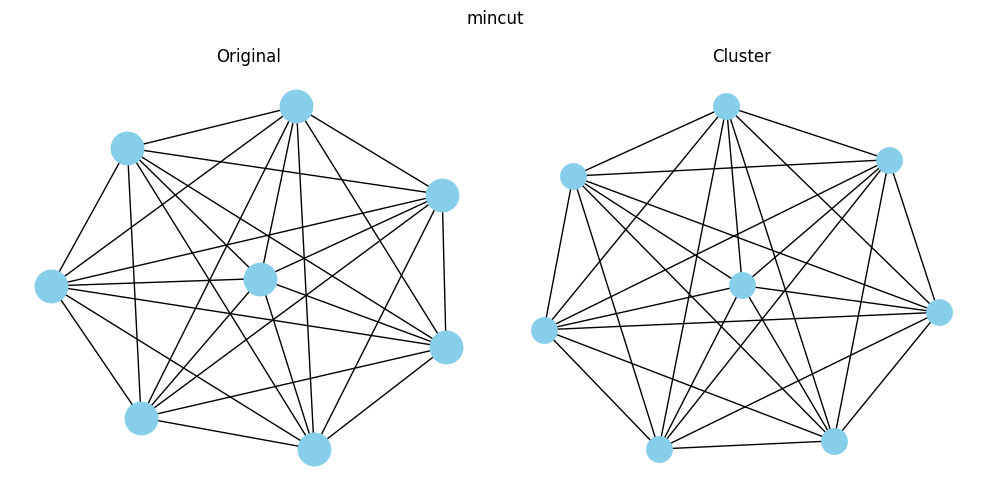

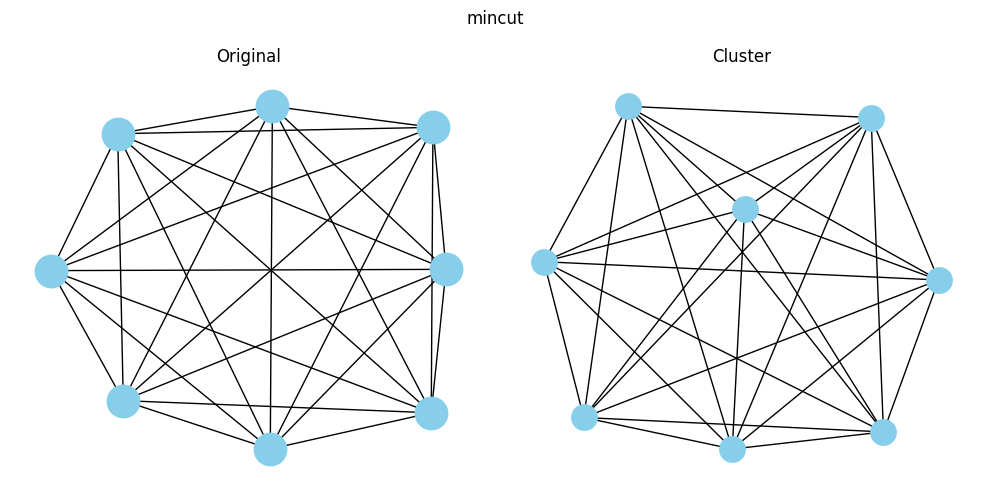

...

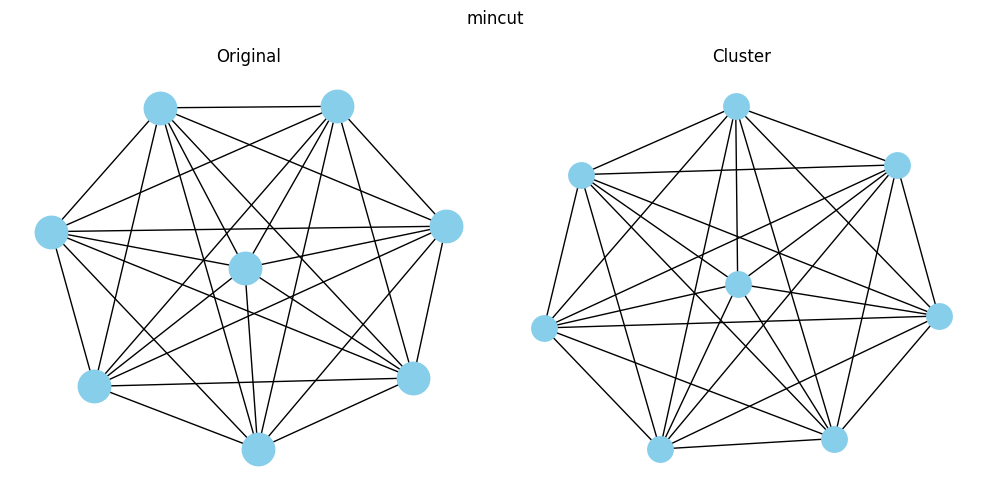

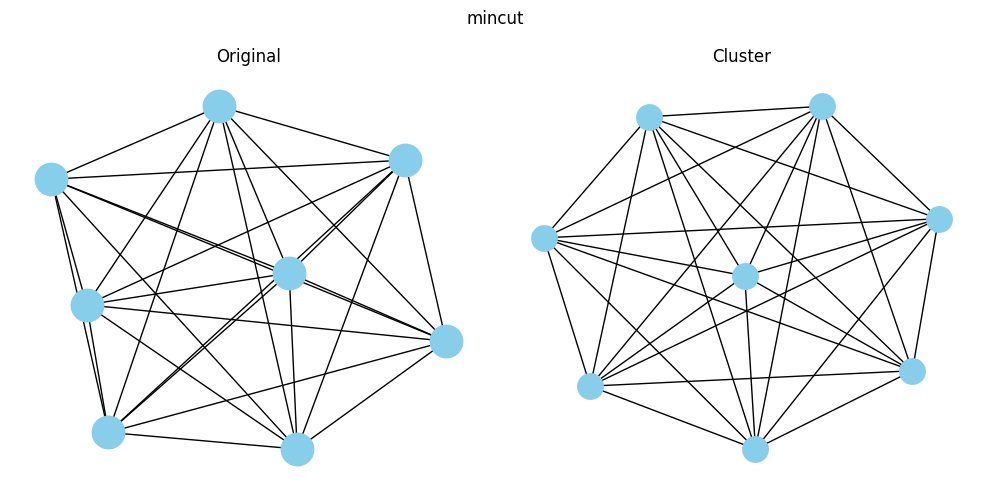

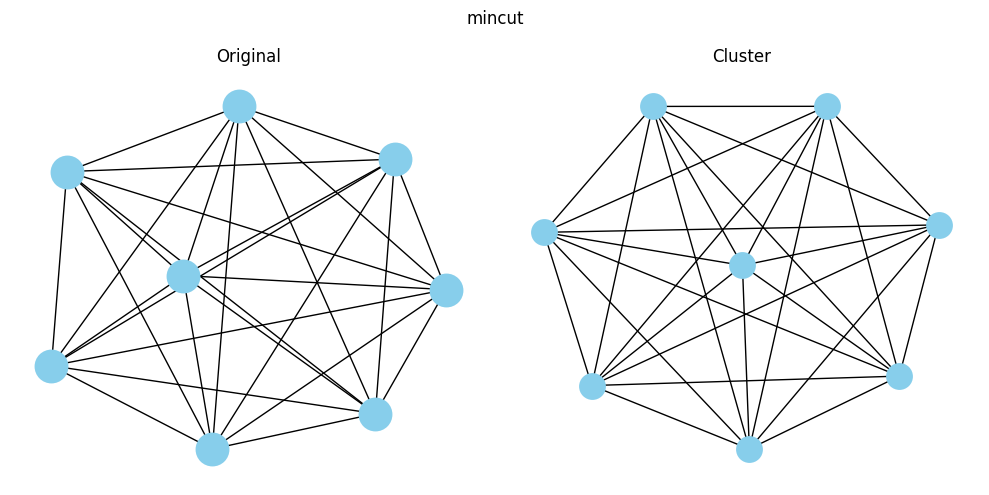

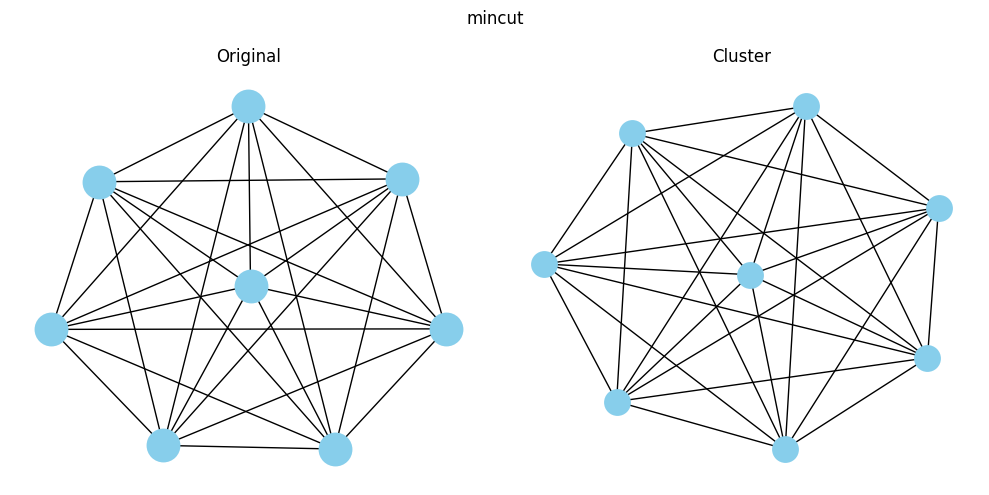

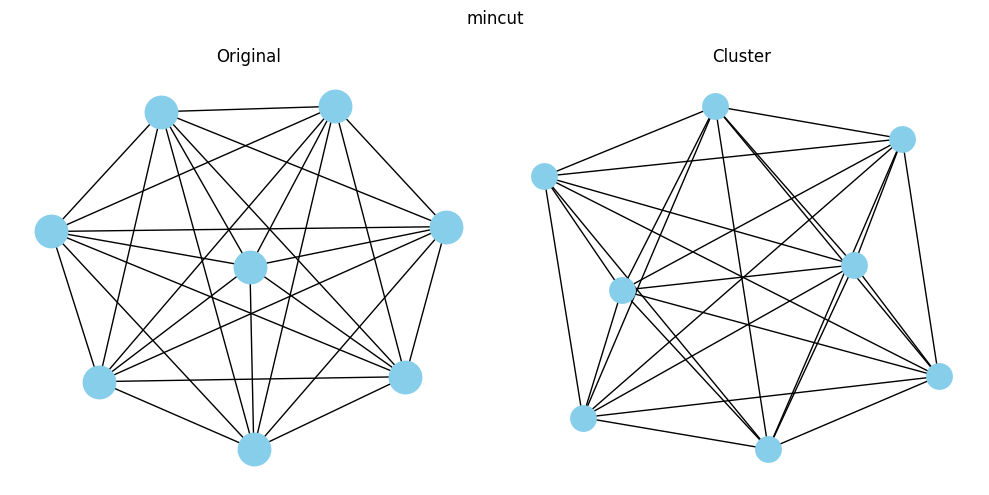

---------------------------------------------------------
9


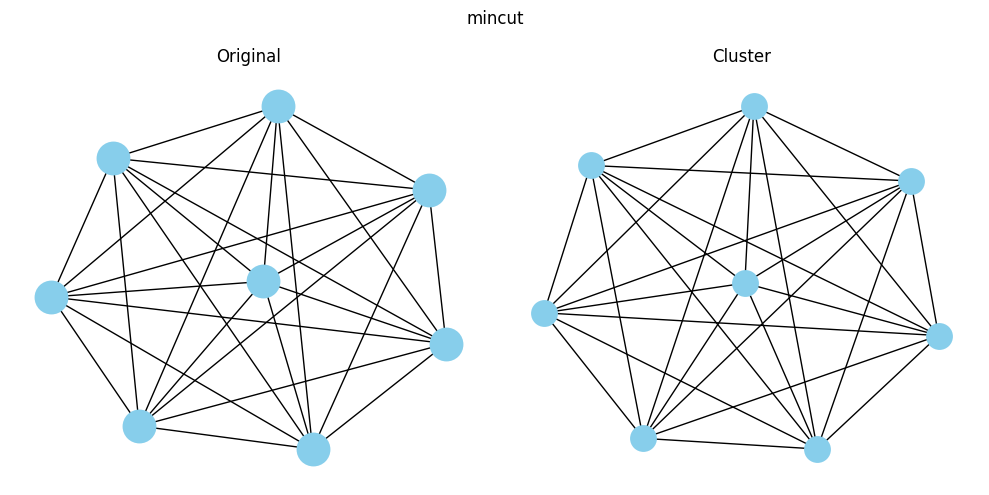

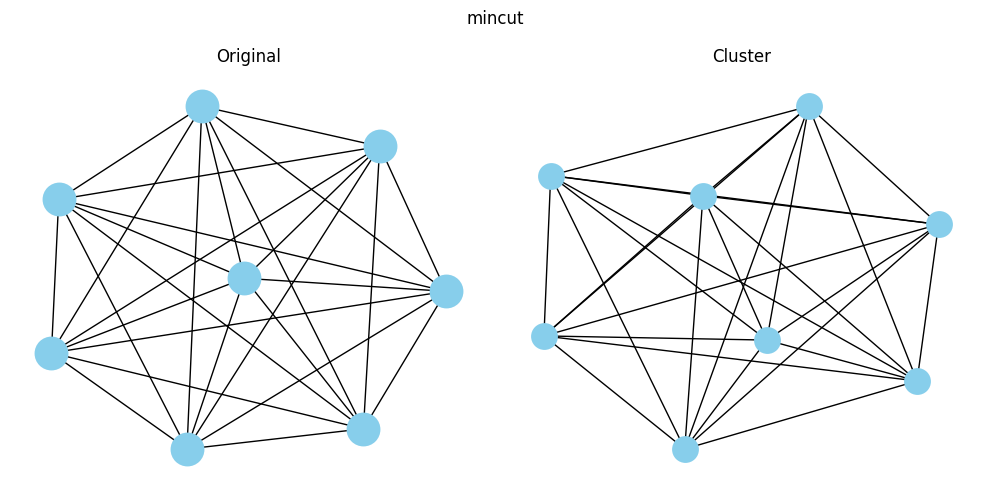

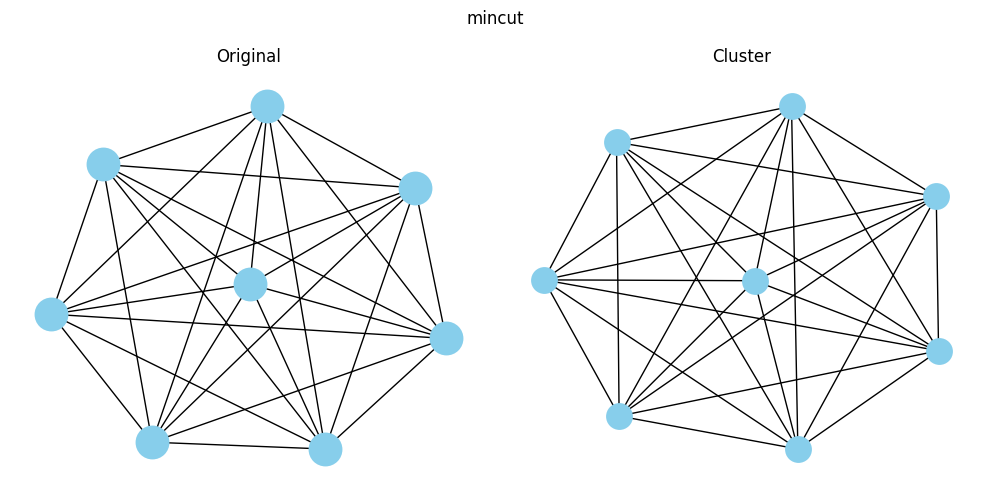

KeyboardInterrupt: 

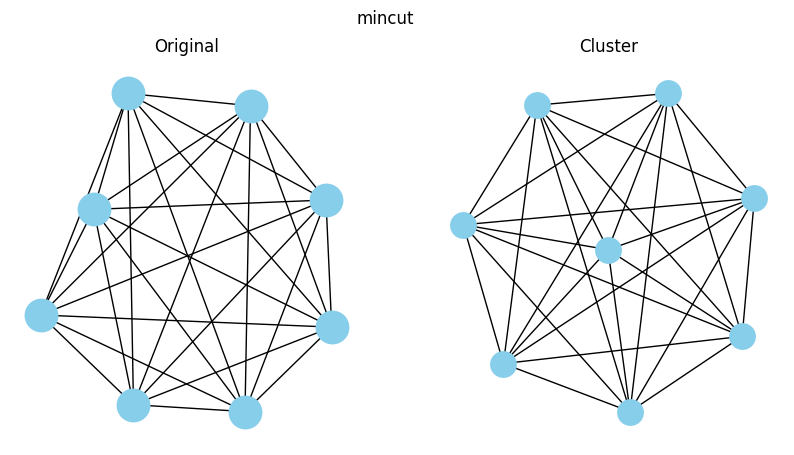

In [30]:
class Args:
    def __init__(self, dim, num_layers, margin, lr, batch_size, num_pairs, n_clusters):
        self.dim = dim
        self.feat_dim = dataset.num_features
        self.num_layers = num_layers
        self.margin = margin
        self.lr = lr
        self.n_classes = dataset.num_classes
        self.batch_size = batch_size
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.n_clusters = n_clusters
        self.num_pairs = num_pairs


dims = [16, 32]
num_layers = [4, 5, 6, 7, 8]
margins = [0.1, 0.3, 0.5, 1]
lrs = [0.01, 0.001]
batch_sizes = [64, 128, 256]
num_pairs = [10000]
n_clusters = [6, 7, 8, 9, 0.5, 0.6, 0.7, 0.8]

hyperparams = hyperparameters_enzymes[1]
newargs = Args(*(*hyperparams, 8))
m = GraphMatchingNetwork(newargs)
o = Adam(m.parameters(), lr=newargs.lr, weight_decay=1e-5)
p, l = create_graph_pairs(data, newargs.num_pairs)
train(m, o, p, l, newargs.batch_size, str(hyperparams), 0.1)
for n in n_clusters:
    print(n)
    for _ in range(10):
        test(m, layers=newargs.num_layers, num_classes=newargs.n_classes, k=n)
    print("---------------------------------------------------------")